In [1]:
%reload_ext autoreload
%autoreload 2

import os
from pathlib import Path
import multiprocessing
from tqdm import tqdm

import arviz as az
import matplotlib.pyplot as plt
import seaborn as sns

import jax
import pandas as pd
import numpy as np
import scipy.stats as stats
import numpyro
from numpyro.diagnostics import hpdi

from hbmep.config import Config
from hbmep.model import Baseline
from hbmep.model.utils import Site as site

PLATFORM = "cpu"
jax.config.update("jax_platforms", PLATFORM)
numpyro.set_platform(PLATFORM)

cpu_count = multiprocessing.cpu_count() - 2
numpyro.set_host_device_count(cpu_count)
numpyro.enable_x64()
numpyro.enable_validation()


In [2]:
root_path = Path(os.getcwd()).parent.parent.parent.parent.absolute()
toml_path = os.path.join(root_path, "configs/shap/fcr.toml")

config = Config(toml_path=toml_path)

model = Baseline(config=config)

df = pd.read_csv(model.csv_path)

ind = df.pulse_amplitude.isin([0])
df = df[~ind].reset_index(drop=True).copy()

""" Process """
df, encoder_dict = model.load(df=df)


2023-08-15 10:42:01,595 - hbmep.config - INFO - Verifying configuration ...
2023-08-15 10:42:01,596 - hbmep.config - INFO - Success!
2023-08-15 10:42:01,617 - hbmep.model.baseline - INFO - Initialized model with baseline link


2023-08-15 10:42:01,665 - hbmep.dataset.core - INFO - Artefacts will be stored here - /home/vishu/repos/hbmep-paper/reports/J_SHAP/fcr
2023-08-15 10:42:01,666 - hbmep.dataset.core - INFO - Copied config to /home/vishu/repos/hbmep-paper/reports/J_SHAP/fcr
2023-08-15 10:42:01,667 - hbmep.dataset.core - INFO - Processing data ...
2023-08-15 10:42:01,672 - hbmep.utils.utils - INFO - func:load took: 0.01 sec


In [3]:
combinations = model._make_combinations(df=df, columns=model.combination_columns)   # sub x pos x charge
combinations_inv = [
    (encoder_dict[model.subject].inverse_transform(np.array([c[0]]))[0], encoder_dict[model.features[0]].inverse_transform(np.array([c[1]]))[0], encoder_dict[model.features[1]].inverse_transform(np.array([c[2]]))[0]) for c in combinations
]

conditions = model._make_combinations(df=df, columns=model.combination_columns[1:]) # pos x charge
conditions_inv = [f"{encoder_dict[model.features[0]].inverse_transform(np.array([pos]))[0]}::{encoder_dict[model.features[1]].inverse_transform(np.array([charge]))[0]}" for pos, charge in conditions]

In [4]:
muscles = ["adm", "biceps", "deltoid", "ecr", "fcr", "triceps"]
a = None

for muscle in muscles:
    a_muscle = None

    for i, c in enumerate(combinations):
        c_inv = combinations_inv[i]
        src = f"/home/vishu/repos/hbmep-paper/reports/J_SHAP/{muscle}/iterative/{c_inv[0]}/{c_inv[1]}/{c_inv[2]}"

        mcmc = az.from_netcdf(os.path.join(src, "mcmc.nc"))["posterior"]
        a_temp = mcmc[site.a].to_numpy()
        a_temp = a_temp[..., 0, 0, 0, 0]
        a_temp = a_temp[..., None]

        if a_muscle is None:
            a_muscle = a_temp
        else:
            a_muscle = np.concatenate((a_muscle, a_temp), axis=-1)

    a_muscle = a_muscle[..., None]

    if a is None:
        a = a_muscle
    else:
        a = np.concatenate((a, a_muscle), axis=-1)

In [6]:
a.shape

(4, 6000, 320, 6)

In [7]:
t = az.summary({
    "a": a
})

In [26]:
combinations_inv[0]

('amap01', '-C7L', '20-0-80-25')

In [28]:
muscles[4]

'fcr'

In [22]:
ind = t.r_hat.apply(lambda x: x > 1.1)
t[ind]

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"a[0, 4]",194.712,2.147,188.585,197.468,0.660,0.480,20.0,13.0,1.13
"a[13, 5]",176.155,128.195,5.594,429.348,26.054,18.650,14.0,16.0,1.20
"a[14, 5]",281.085,8.553,273.452,296.804,4.222,3.230,7.0,28.0,1.53
"a[21, 3]",158.292,109.105,48.154,368.100,37.150,28.226,14.0,39.0,1.20
"a[25, 1]",181.745,84.505,59.701,426.544,2.510,2.049,1886.0,784.0,1.20
"a[28, 0]",306.273,91.277,188.207,399.670,44.635,34.469,6.0,98.0,1.73
"a[33, 4]",179.746,145.776,15.302,450.213,42.977,31.194,9.0,94.0,1.37
"a[37, 4]",322.457,107.755,119.399,399.578,48.771,37.384,8.0,70.0,1.46
"a[40, 2]",304.804,55.654,255.492,411.869,27.365,20.994,7.0,27.0,1.53
"a[41, 2]",367.974,59.341,266.305,421.782,27.413,20.738,8.0,37.0,1.46


In [17]:
ind = np.where(t.r_hat > 1.05)

In [18]:
t[np.where(t.r_hat > 1.05)]

InvalidIndexError: (array([   4,   29,   37,   83,   89,  129,  151,  168,  172,  202,  226,
        242,  248,  254,  267,  268,  280,  299,  302,  308,  311,  333,
        345,  387,  395,  398,  406,  408,  410,  430,  529,  557,  560,
        611,  619,  633,  674,  746,  831,  867,  874,  908, 1044, 1202,
       1208, 1255, 1262, 1297, 1303, 1305, 1309, 1405, 1409, 1421, 1427,
       1429, 1433, 1446, 1486, 1534, 1547, 1588, 1590, 1661, 1720, 1803,
       1817, 1830]),)

In [16]:
t.loc[ind]

KeyError: "None of [Index([   4,   29,   37,   83,   89,  129,  151,  168,  172,  202,  226,  242,\n        248,  254,  267,  268,  280,  299,  302,  308,  311,  333,  345,  387,\n        395,  398,  406,  408,  410,  430,  529,  557,  560,  611,  619,  633,\n        674,  746,  831,  867,  874,  908, 1044, 1202, 1208, 1255, 1262, 1297,\n       1303, 1305, 1309, 1405, 1409, 1421, 1427, 1429, 1433, 1446, 1486, 1534,\n       1547, 1588, 1590, 1661, 1720, 1803, 1817, 1830],\n      dtype='int64')] are in the [index]"

In [9]:
t.r_hat.max()

1.73

In [8]:
t.head()

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
"a[0, 0]",288.280,21.416,252.149,319.471,0.314,0.224,5176.0,11174.0,1.00
"a[0, 1]",192.330,1.905,188.862,195.549,0.020,0.014,9987.0,9623.0,1.00
"a[0, 2]",179.328,8.780,161.425,196.456,0.078,0.055,13321.0,11048.0,1.00
"a[0, 3]",204.641,5.137,195.043,214.970,0.074,0.052,5162.0,4762.0,1.00
"a[0, 4]",194.712,2.147,188.585,197.468,0.660,0.480,20.0,13.0,1.13


In [6]:
a = a.reshape(-1, *a.shape[2:])
a = np.array(jax.random.permutation(model.rng_key, x=a, axis=0, independent=True))
a_map = a.mean(axis=0)

a.shape

(24000, 320, 6)

In [7]:
def _process(keep_muscles: list[str]):
    keep_muscles_ind = [i for i, muscle in enumerate(muscles) if muscle in keep_muscles]

    pr = []
    effect_size = []
    t_test = []
    rank_test = []
    heat_map = []

    for i, (i_pos, i_charge) in enumerate(conditions):
        curr_pr = []
        curr_effect_size = []
        curr_t_test = []
        curr_rank_test = []
        curr_heat_map = []

        for j, (j_pos, j_charge) in enumerate(conditions):
            if i == j:
                curr_pr.append(0)
                curr_effect_size.append((0, 0))
                curr_t_test.append(1)
                curr_rank_test.append(1)
                curr_heat_map.append(f"D")
                continue

            i_com = [(i, c) for i, c in enumerate(combinations) if (c[1], c[2]) == (i_pos, i_charge)]
            j_com = [(j, c) for j, c in enumerate(combinations) if (c[1], c[2]) == (j_pos, j_charge)]

            i_com = sorted(i_com, key=lambda x: x[1][0])
            j_com = sorted(j_com, key=lambda x: x[1][0])

            i_sub = set([v[1][0] for v in i_com])
            j_sub = set([v[1][0] for v in j_com])
            common_sub = list(i_sub.intersection(j_sub))

            i_ind = [v[0] for v in i_com if v[1][0] in common_sub]
            j_ind = [v[0] for v in j_com if v[1][0] in common_sub]

            N = len(common_sub) * len(keep_muscles_ind)

            if not len(common_sub):
                curr_pr.append(0)
                curr_effect_size.append((0, 0))
                curr_t_test.append(1)
                curr_rank_test.append(1)
                curr_heat_map.append(f"NA:0")
                continue

            ## Distributions
            i_a = a[:, i_ind, ...]
            i_a = i_a[..., keep_muscles_ind]
            i_a = i_a.reshape(i_a.shape[0], -1)

            j_a = a[:, j_ind, ...]
            j_a = j_a[..., keep_muscles_ind]
            j_a = j_a.reshape(j_a.shape[0], -1)

            diff_a = i_a - j_a
            diff_a_mu = diff_a.mean(axis=-1)
            pr_a_mu = (diff_a_mu < 0).mean()
            curr_pr.append(pr_a_mu)

            ## Effect-size
            i_mu_a_estimate = i_a.mean(axis=-1)
            i_sigma_sq_a_estimate = np.power(i_a - i_mu_a_estimate[:, None], 2).sum(axis=-1) / (N - 1)

            j_mu_a_estimate = j_a.mean(axis=-1)
            j_sigma_sq_a_estimate = np.power(j_a - j_mu_a_estimate[:, None], 2).sum(axis=-1) / (N - 1)

            i_j_effect_size = (i_mu_a_estimate - j_mu_a_estimate) / np.power( (i_sigma_sq_a_estimate + j_sigma_sq_a_estimate) / 2, 0.5)
            hpdi_interval_lo, hpdi_interval_hi = hpdi(i_j_effect_size, prob=.95)
            curr_effect_size.append((hpdi_interval_lo, hpdi_interval_hi))

            curr_heat_map.append(f"{pr_a_mu:.2f}:{len(common_sub)}\n({hpdi_interval_lo:.2f}, {hpdi_interval_hi:.2f})")

            ## MAP
            i_map = a_map[i_ind, ...]
            i_map = i_map[..., keep_muscles_ind]
            i_map = i_map.reshape(-1,)

            j_map = a_map[j_ind, ...]
            j_map = j_map[..., keep_muscles_ind]
            j_map = j_map.reshape(-1,)

            diff_map = i_map - j_map
            t_test_map = stats.ttest_1samp(a=diff_map, popmean=0, alternative="less")
            rank_test_map = stats.wilcoxon(x=diff_map, alternative="less")

            curr_t_test.append(t_test_map.pvalue)
            curr_rank_test.append(rank_test_map.pvalue)

        pr.append(curr_pr)
        effect_size.append(curr_effect_size)
        t_test.append(curr_t_test)
        rank_test.append(curr_rank_test)
        heat_map.append(curr_heat_map)

    pr = np.array(pr)
    effect_size = np.array(effect_size)
    t_test = np.array(t_test)
    rank_test = np.array(rank_test)
    heat_map = np.array(heat_map)
    return pr, effect_size, t_test, rank_test, heat_map

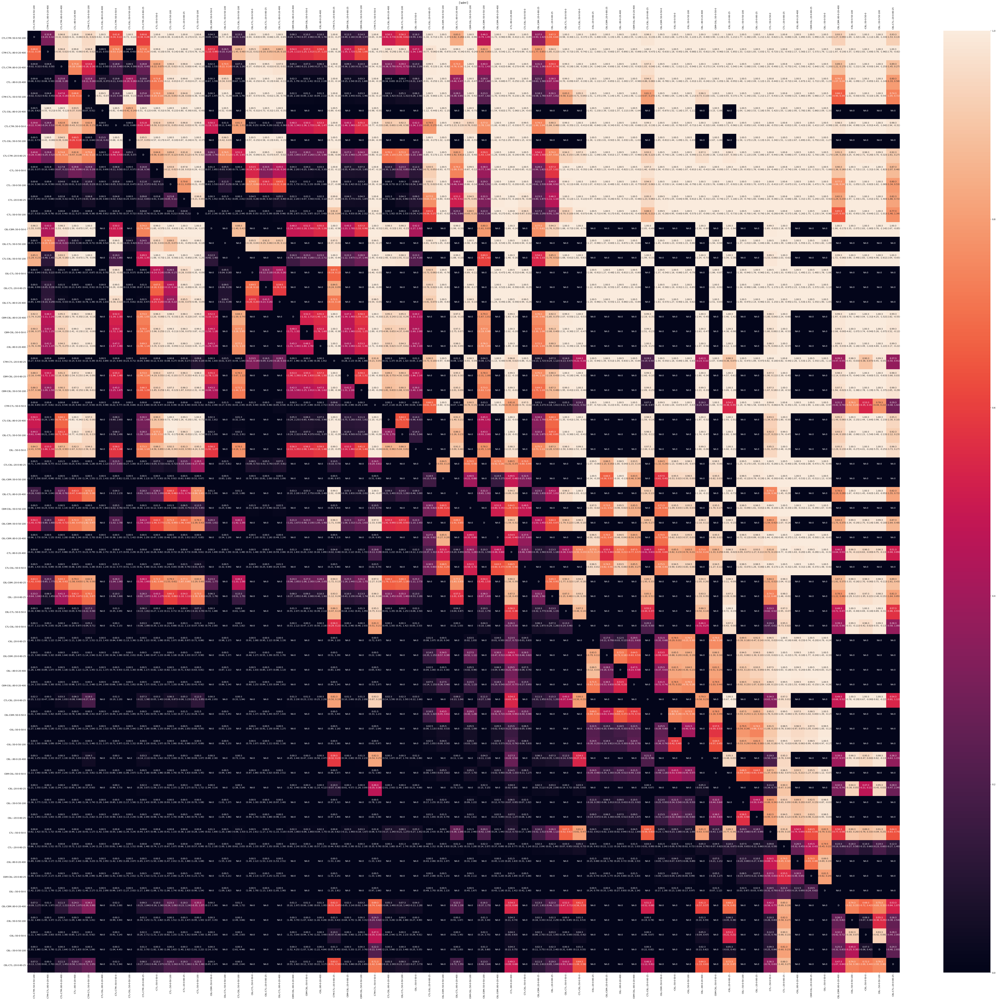

In [8]:
keep_muscles = ["adm"]
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");


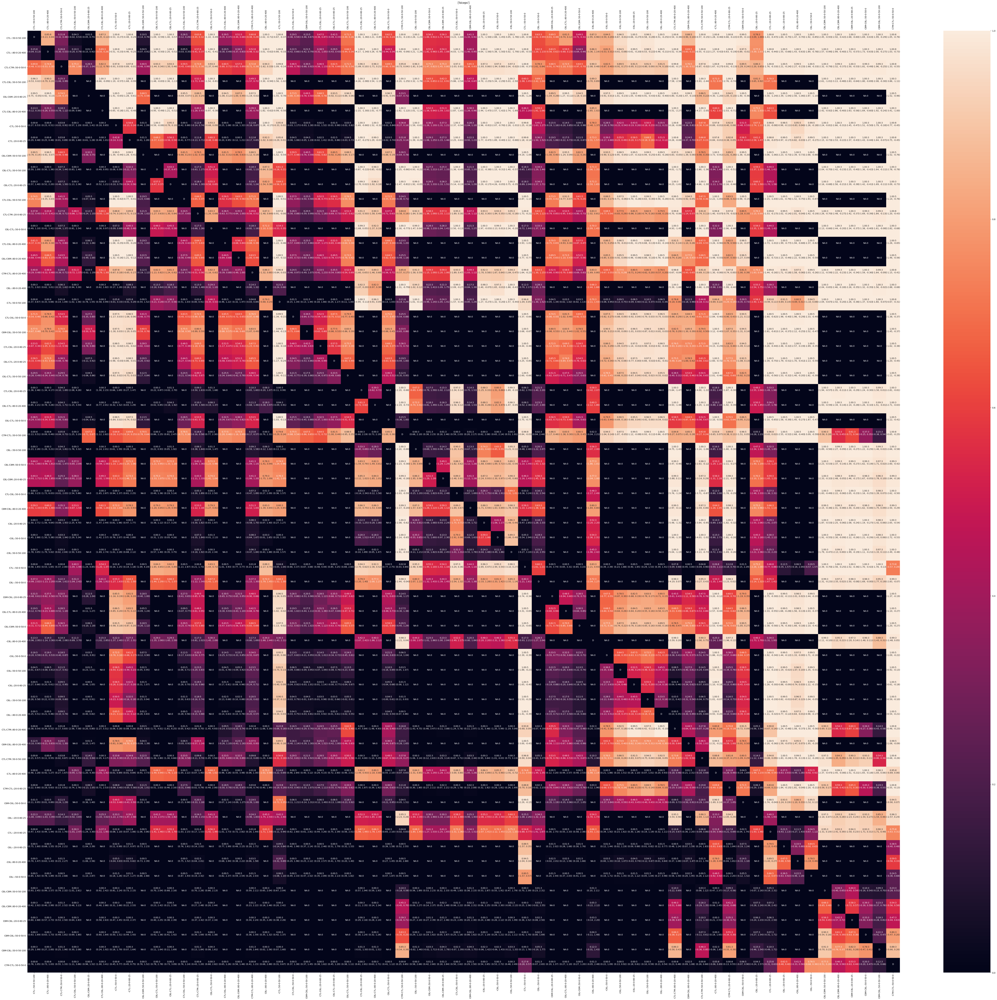

In [9]:
keep_muscles = ["biceps"]
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");

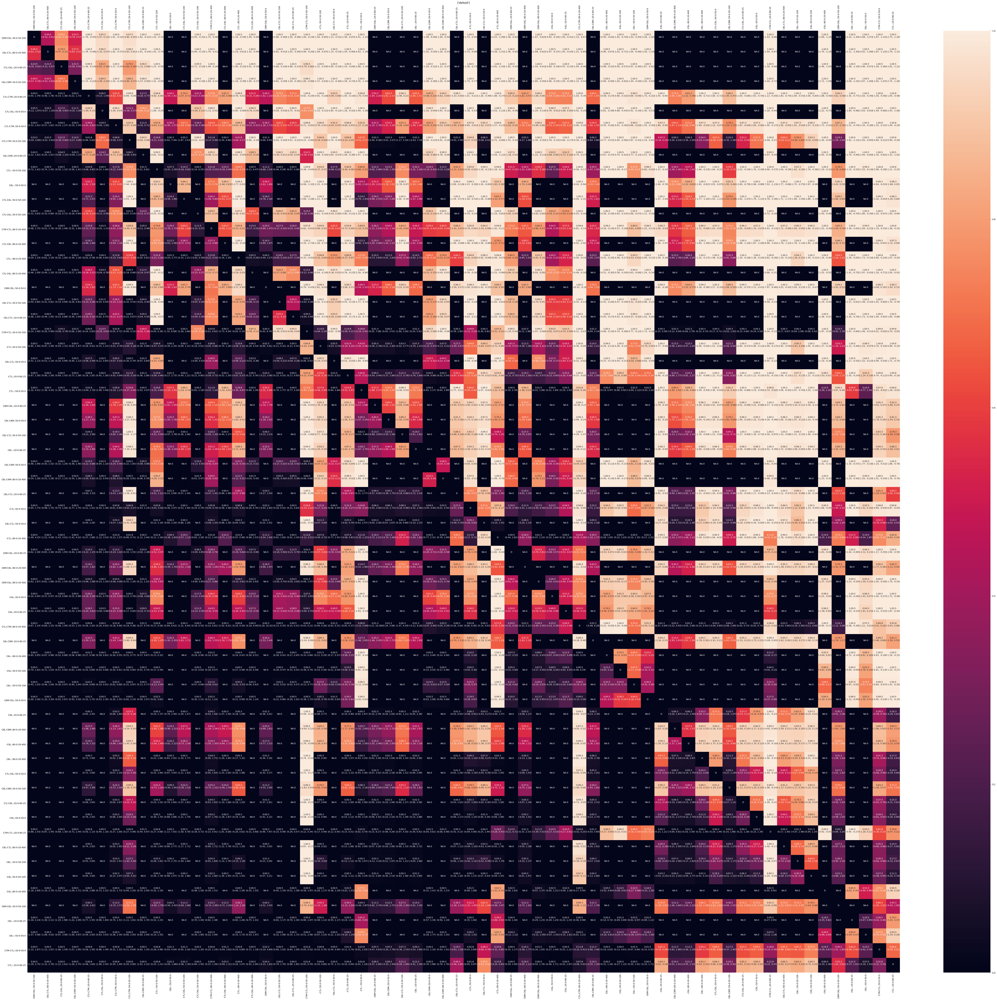

In [10]:
keep_muscles = ["deltoid"]
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");

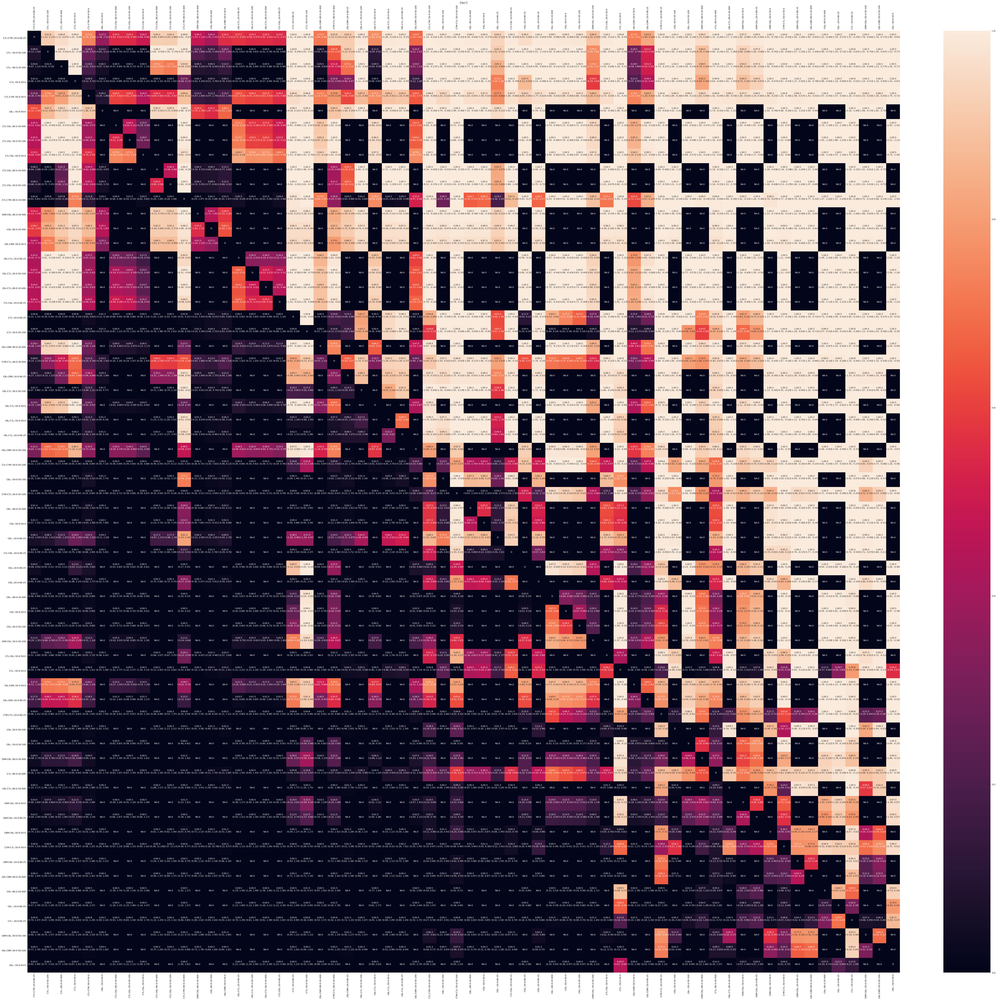

In [11]:
keep_muscles = ["ecr"]
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");


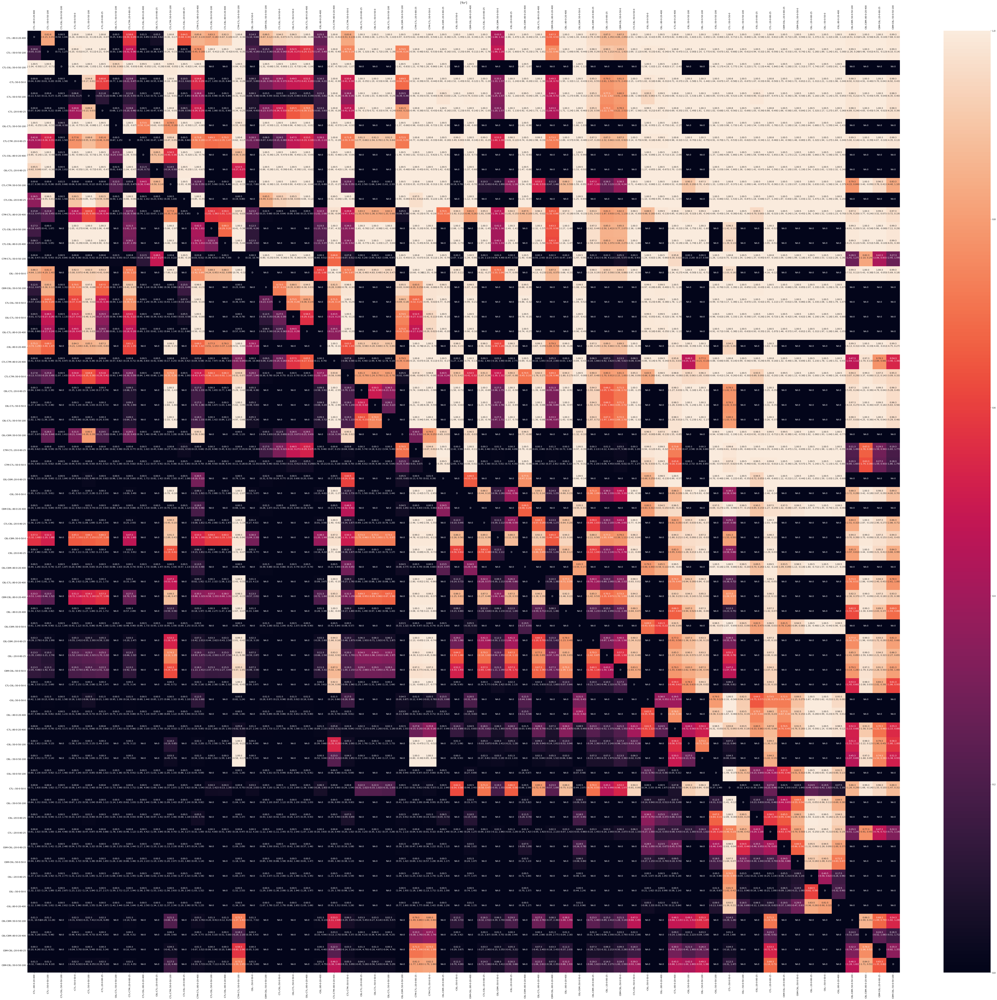

In [12]:
keep_muscles = ["fcr"]
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");

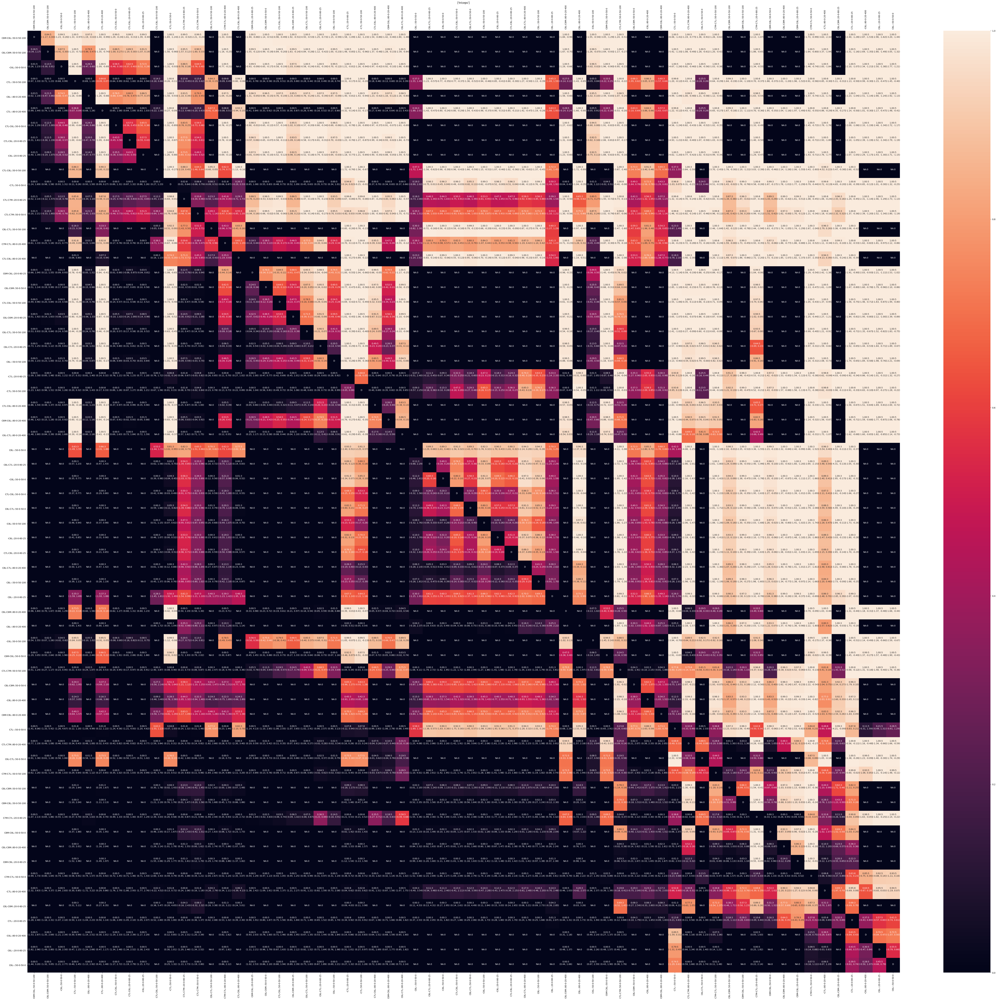

In [13]:
keep_muscles = ["triceps"]
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");

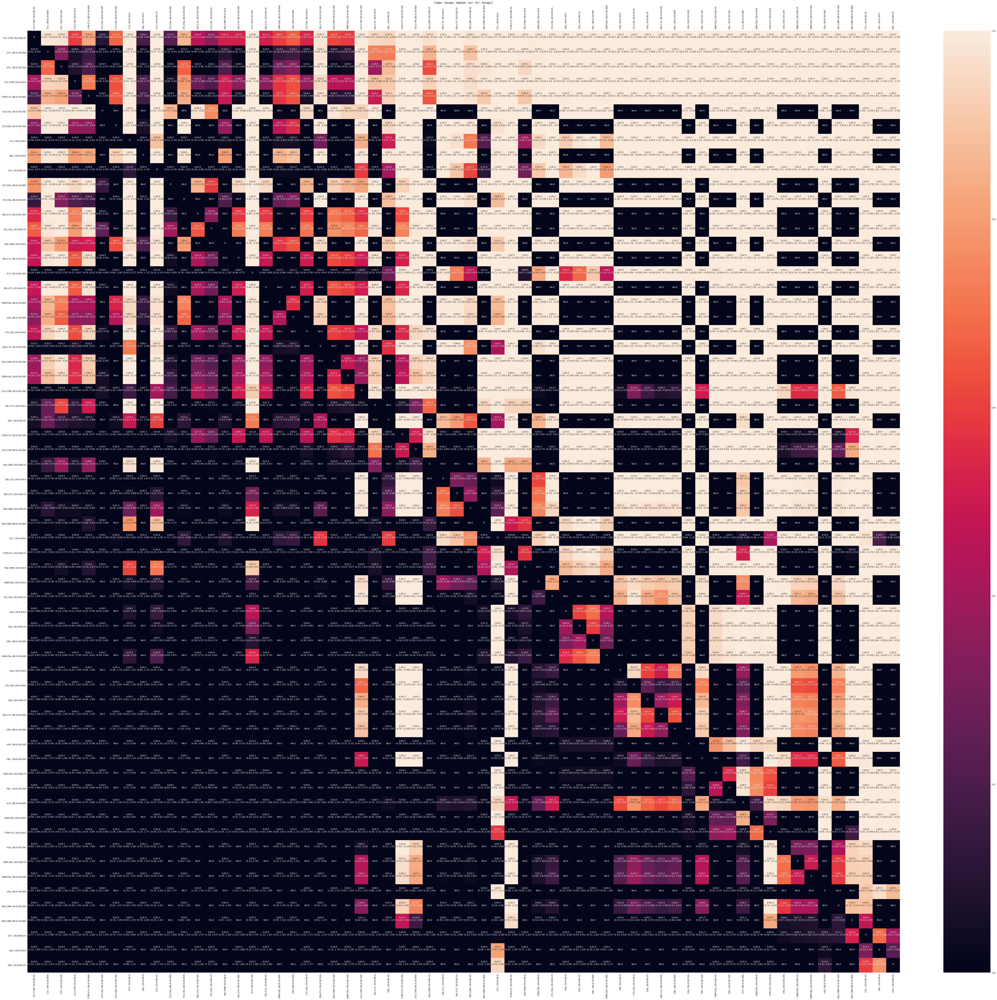

In [14]:
keep_muscles = muscles
pr, effect_size, t_test, rank_test, heat_map = _process(keep_muscles=keep_muscles)

plt.figure(figsize=(64, 64), constrained_layout=True)

ind = np.argsort(-(pr > .95).sum(axis=1))
sns.heatmap(pr[ind, :][:, ind], annot=False)
sns.heatmap(pr[ind, :][:, ind], annot=heat_map[ind, :][:, ind], annot_kws={'va':'bottom'}, fmt="", cbar=False, xticklabels=np.array(conditions_inv)[ind], yticklabels=np.array(conditions_inv)[ind])

plt.tick_params(labeltop=True)
plt.xticks(rotation=90)
plt.title(f"{keep_muscles}");

In [15]:
(pr > .95).sum(axis=1).max()

45